## Project 2 : Are LEGOs getting more and more expensive?

### [Brickset](Brickset.com) is the most established, accurate and up-to-date online LEGO database today: it contains thorough information on 15089 LEGO sets and other items released over the last 69 years.
### I contacted them and they generously offered me their complete dataset for this project.

### Apart from this dataset, I also collected data on inflation by the [Federal Reserve Bank of St. Louis](https://fred.stlouisfed.org). 


In [52]:
import pandas as pd
import matplotlib
% matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image 
import re
from cycler import cycler
import squarify


In [54]:
plt.rcdefaults()
plt.rcParams.update({
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'figure.facecolor'    : '#FDF6E3',
    'figure.figsize'      : (11,7),
    'patch.antialiased'   : True,
    'lines.linewidth'     : 2.0,
    'lines.solid_capstyle': 'butt',
    'font.family'         : 'sans-serif',    
    'font.style' : 'normal',
    'font.weight': 'medium',
    'axes.titlesize'      : 'large' , 
    'axes.titleweight'      : 'bold' , 
    'axes.titlepad'       : 32    ,
    'axes.labelsize'      : 12,
    'axes.labelcolor'     : '#657b83',
    'axes.facecolor'      : '#eee8d5',
    'axes.edgecolor'      : '#eee8d5',
    'axes.axisbelow'      : True,
    'axes.prop_cycle'    : cycler('color', ['#749abd', '#c6d3df', '#859900', '#9ea1a3', '#3e5569', '#eff5fb', '#268bd2', '#6c71c4']),
    'axes.grid'           : True,
    'grid.color'          : '#fdf6e3',   
    'grid.linestyle'      : '-',         
    'grid.linewidth'      : 1.5,         
    'xtick.color'         : '#657b83',
    'xtick.direction'     : 'out',
    'ytick.color'         : '#657b83',
    'ytick.direction'     : 'out',
    'text.color'          : '#657b83',
})

In [3]:
df=pd.read_csv("all_brickset.csv")
df.head()

,SetID,Number,Variant,ThemeGroup,Theme,SubTheme,Year,Name,Minifigs,Pieces,...,CARetailPrice,EURetailPrice,Image,ImageFilename,EAN,UPC,PackagingType,Availability,InstructionsCount,AdditionalImageCount
0,7326,102A,1,Vintage themes,LEGOLAND,Vehicle,1970,Front-End Loader,NaN,57.0,...,NaN,NaN,True,102A-1,NaN,NaN,{Not specified},{Not specified},0,0
1,25170,1200M,1,Basic,System,Town Plan,1957,LEGO Town Plan Wooden Board,NaN,NaN,...,NaN,NaN,False,NaN,NaN,NaN,{Not specified},{Not specified},0,0
2,25260,1224_1,1,Basic,System,Supplemental,1955,8 Danish Named Beams,NaN,NaN,...,NaN,NaN,False,NaN,NaN,NaN,{Not specified},{Not specified},0,0
3,25183,1224A,1,Basic,System,Supplemental,1955,1 x 6 and 1 x 8 Bricks,NaN,NaN,...,NaN,NaN,False,NaN,NaN,NaN,{Not specified},{Not specified},0,0
4,25252,1242D,1,Basic,System,Supplemental,1957,5 Danish Flags,NaN,NaN,...,NaN,NaN,False,NaN,NaN,NaN,{Not specified},{Not specified},0,0


In [4]:
df.drop(['SetID', 'Number', 'CARetailPrice', 'EURetailPrice','Image','ImageFilename','EAN','UPC','PackagingType','Availability','AdditionalImageCount','UKRetailPrice','Variant'], axis=1, inplace=True)

In [5]:
df.head()

,ThemeGroup,Theme,SubTheme,Year,Name,Minifigs,Pieces,USRetailPrice,InstructionsCount
0,Vintage themes,LEGOLAND,Vehicle,1970,Front-End Loader,NaN,57.0,NaN,0
1,Basic,System,Town Plan,1957,LEGO Town Plan Wooden Board,NaN,NaN,NaN,0
2,Basic,System,Supplemental,1955,8 Danish Named Beams,NaN,NaN,NaN,0
3,Basic,System,Supplemental,1955,1 x 6 and 1 x 8 Bricks,NaN,NaN,NaN,0
4,Basic,System,Supplemental,1957,5 Danish Flags,NaN,NaN,NaN,0


In [6]:
df = df[(df['Year'] >= 1967) & (df['Year'] < 2018)]
df.reset_index(inplace=True)

In [7]:
df_mean_price = df.groupby(df.Year).USRetailPrice.mean().reset_index()

In [8]:
df_mean_price.sort_values(by= 'USRetailPrice')

,Year,USRetailPrice
3,1970,5.990000
15,1982,6.250000
0,1967,6.642667
5,1972,7.982000
4,1971,8.192487
2,1969,8.847143
7,1974,9.333333
11,1978,10.055556
12,1979,11.541429
20,1987,12.319667


In [9]:
df_mean_price.Year.astype(int, inplace=True)

0     1967
1     1968
2     1969
3     1970
4     1971
5     1972
6     1973
7     1974
8     1975
9     1976
10    1977
11    1978
12    1979
13    1980
14    1981
15    1982
16    1983
17    1984
18    1985
19    1986
20    1987
21    1988
22    1989
23    1990
24    1991
25    1992
26    1993
27    1994
28    1995
29    1996
30    1997
31    1998
32    1999
33    2000
34    2001
35    2002
36    2003
37    2004
38    2005
39    2006
40    2007
41    2008
42    2009
43    2010
44    2011
45    2012
46    2013
47    2014
48    2015
49    2016
50    2017
Name: Year, dtype: int64

In [10]:
df_mean_price.head()

,Year,USRetailPrice
0,1967,6.642667
1,1968,14.687114
2,1969,8.847143
3,1970,5.990000
4,1971,8.192487


### 1. Are LEGO's getting more expensive?

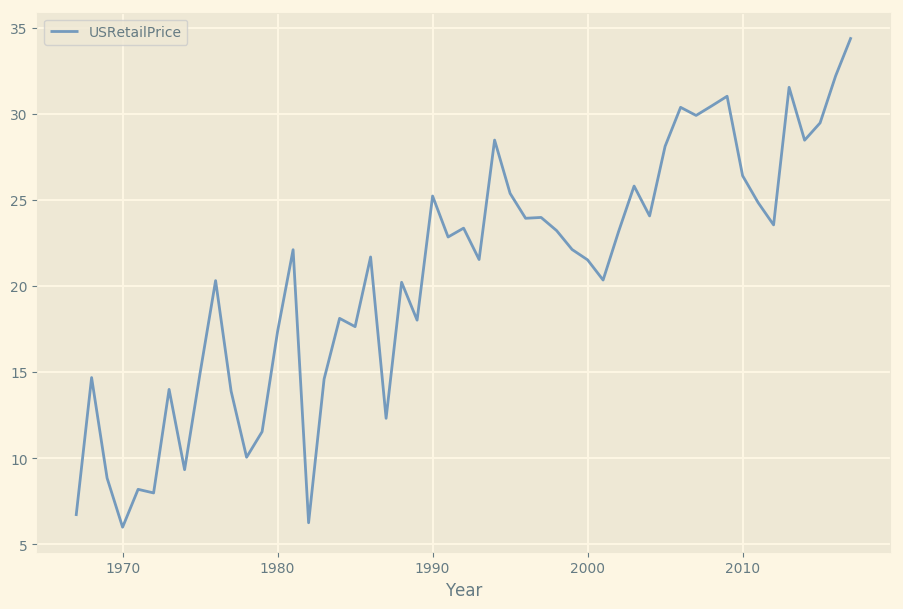

In [34]:
df_mean_price.dropna().plot(x = 'Year', y= 'USRetailPrice') 


plt.show()

In [12]:
# Adjusting this for inflation
inflation = pd.read_csv('infl.csv')
inflation['CPI_Multiplier'] = inflation['CPIAUCNS'].iloc[-1] / inflation['CPIAUCNS']
inflation ['Year'] = inflation.DATE.str.extract(r'(^\d\d\d\d)')

In [13]:
inflation ['Year']= inflation.Year.astype(int, inplace=True)

In [14]:
df_wth_inlftn = pd.merge(df_mean_price, inflation,on='Year')

In [15]:
df_wth_inlftn.drop(columns = 'DATE',inplace=True)

In [16]:
df_wth_inlftn.head()

,Year,USRetailPrice,CPIAUCNS,CPI_Multiplier
0,1967,6.642667,33.358333,7.348076
1,1968,14.687114,34.783333,7.047041
2,1969,8.847143,36.683333,6.682042
3,1970,5.990000,38.825000,6.313447
4,1971,8.192487,40.491667,6.053581


In [17]:
df_wth_inlftn['AdjPrice'] = df_wth_inlftn['USRetailPrice'] * df_wth_inlftn['CPI_Multiplier'] 


In [18]:
df_wth_inlftn.head()

,Year,USRetailPrice,CPIAUCNS,CPI_Multiplier,AdjPrice
0,1967,6.642667,33.358333,7.348076,48.810822
1,1968,14.687114,34.783333,7.047041,103.500700
2,1969,8.847143,36.683333,6.682042,59.116982
3,1970,5.990000,38.825000,6.313447,37.817548
4,1971,8.192487,40.491667,6.053581,49.593887


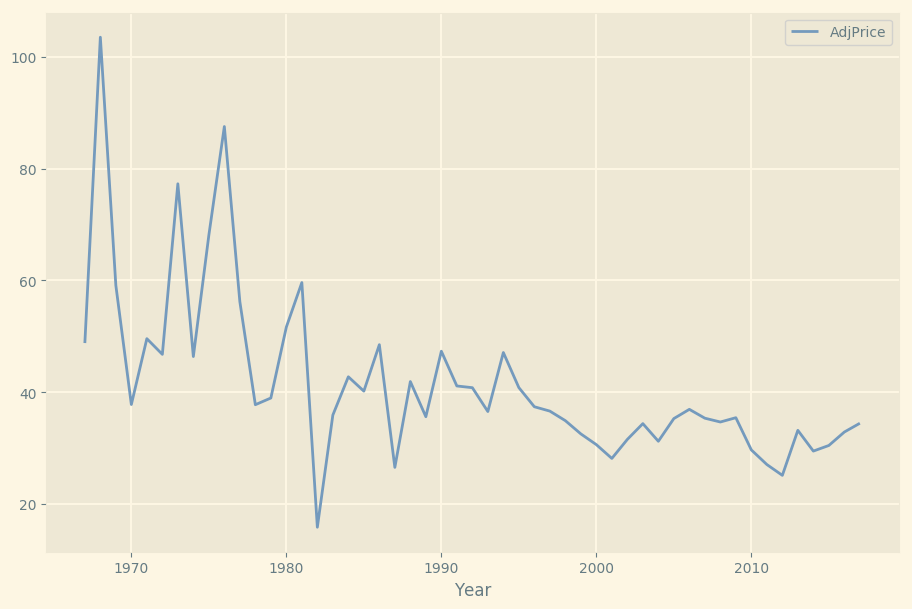

In [37]:
df_wth_inlftn.dropna().plot(x = 'Year', y= 'AdjPrice') #1967-2017 adjusted for inflation
plt.savefig("lego_prc.pdf")
plt.show()

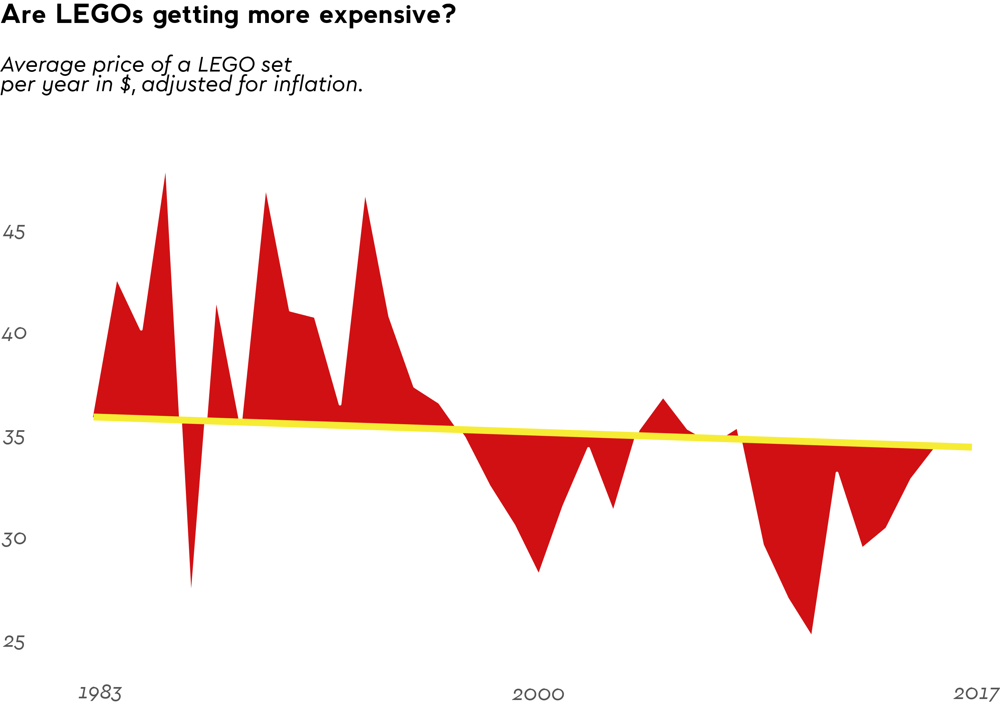

In [20]:
#Draft graph on illustrator
Image(filename='lego_prc.png')


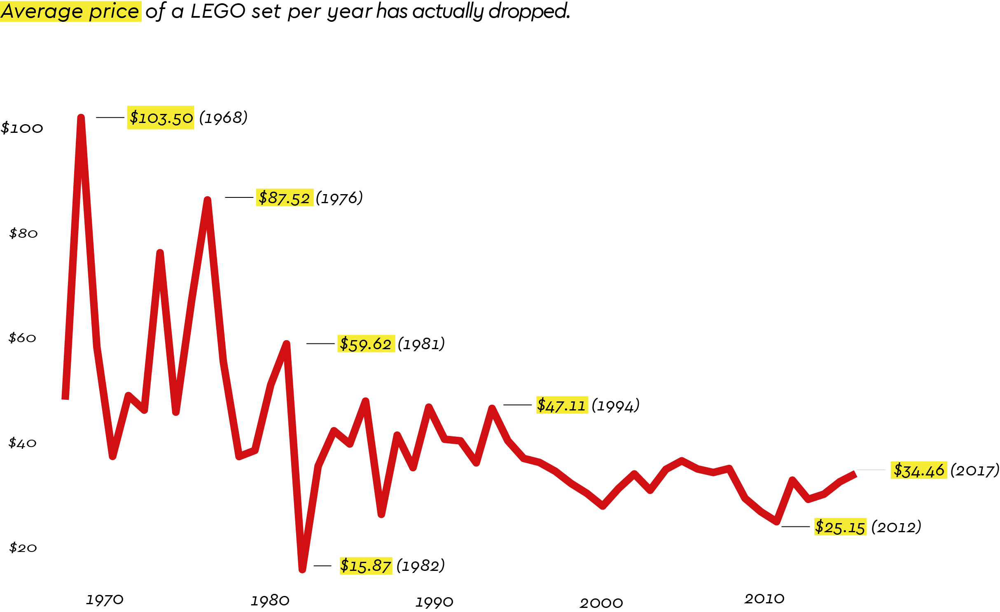

In [160]:
#Final
Image(filename='Lego1.png')

### 2. Median vs mean price

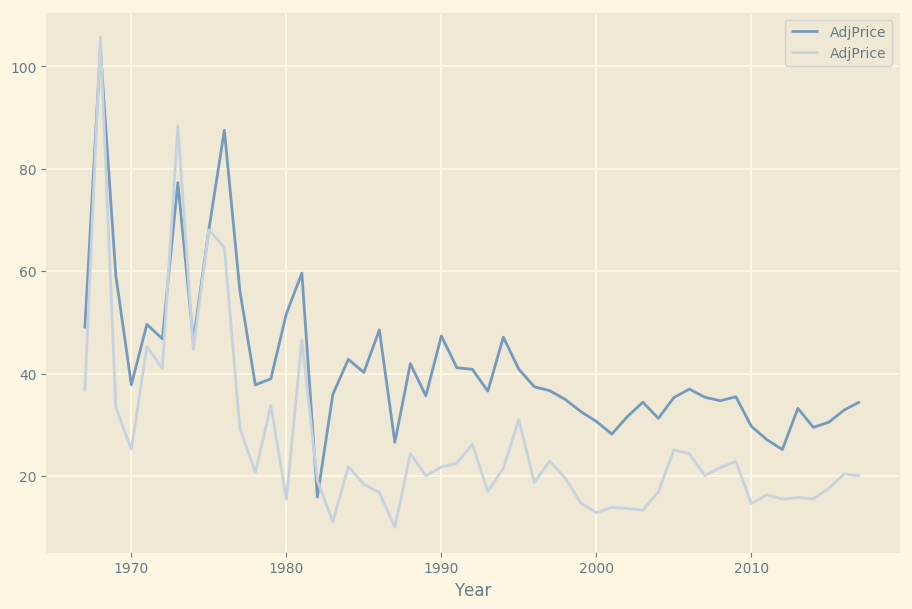

In [38]:
df_median_price = df.groupby(df.Year).USRetailPrice.median().reset_index()
df_median_price.Year.astype(int, inplace=True)
df_mdn_wth_inlftn = pd.merge(df_median_price, inflation,on='Year')
df_mdn_wth_inlftn['AdjPrice'] = df_mdn_wth_inlftn['USRetailPrice'] * df_mdn_wth_inlftn['CPI_Multiplier'] 
fig, ax = plt.subplots()


ax1 = df_wth_inlftn.dropna().plot(x = 'Year', y= 'AdjPrice',ax=ax)
ax2 = df_mdn_wth_inlftn.dropna().plot(x = 'Year', y= 'AdjPrice',ax=ax) 


plt.savefig("lego_median_prc.pdf")
plt.show()

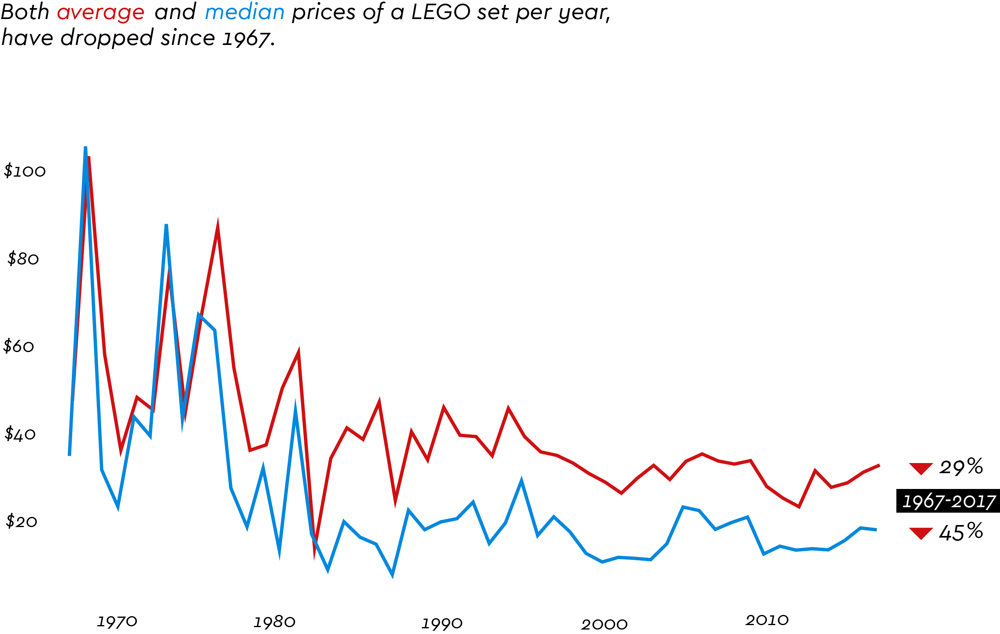

In [159]:
Image(filename='Lego2.png')

### 3 Most expensive sets ever

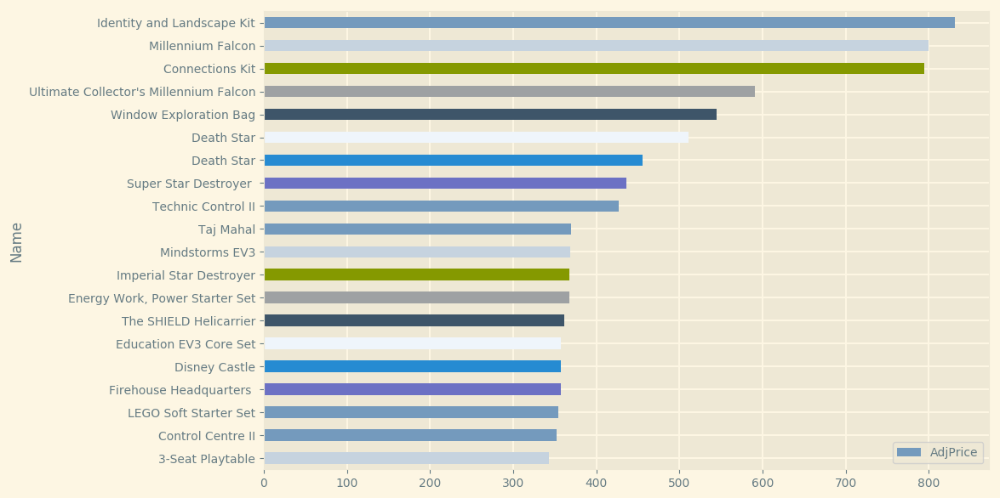

In [39]:
topsets=f_df_wth_inlftn[['Name','Year','Pieces','AdjPrice']]
topsets=topsets.sort_values (by='AdjPrice', ascending=False)
topsets.dropna().head(20).plot(x='Name',y='AdjPrice',kind='barh')
plt.gca().invert_yaxis()
plt.savefig("lego_most_expensive_set.pdf",bbox_inches='tight')
plt.show()




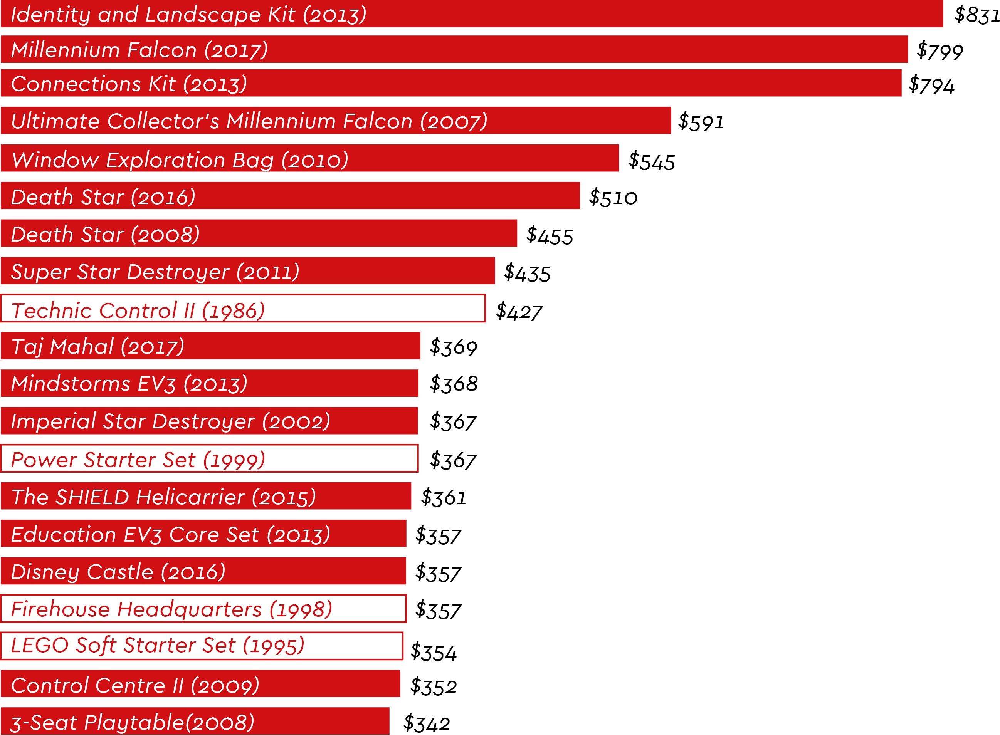

In [161]:
Image(filename='Lego3.png')

### 4. Average pieces/set/period

In [26]:
df.Pieces.fillna(0,inplace=True)

In [138]:
#Putting data into decade groups and normalizing
brickpiece = df.groupby(df.Year).Pieces.mean().reset_index()
bricklist=[]
six=brickpiece.iloc[0:3].Pieces.sum()/3
bricklist.append(six)
seven=brickpiece.iloc[4:13].Pieces.sum()/10
bricklist.append(seven)
eight=brickpiece.iloc[14:23].Pieces.sum()/10
bricklist.append(eight)
nine=brickpiece.iloc[24:33].Pieces.sum()/10
bricklist.append(nine)
ten=brickpiece.iloc[34:43].Pieces.sum()/10
bricklist.append(ten)
eleven=brickpiece.iloc[44:50].Pieces.sum()/7
bricklist.append(eleven)
brickpiece=pd.DataFrame(bricklist)

In [139]:
brickpiece.rename(index=str, columns={0: "pieces"},inplace=True)

In [140]:
brickpiece

,pieces
0,122.939045
1,121.519072
2,85.968409
3,110.023562
4,141.993948
5,145.609242


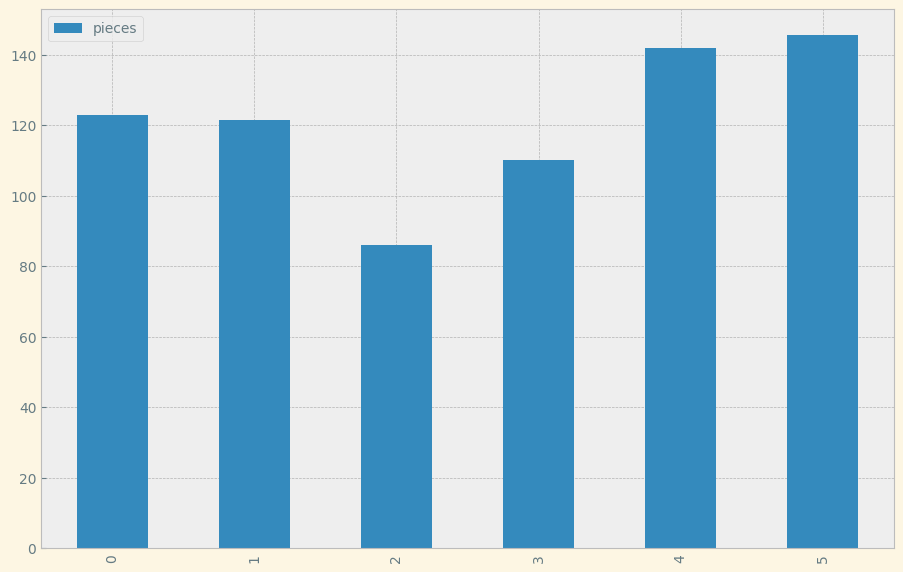

<Figure size 1100x700 with 0 Axes>

In [146]:
brickpiece.plot(kind='bar') 
plt.show()
plt.savefig("lego_pieces.pdf")



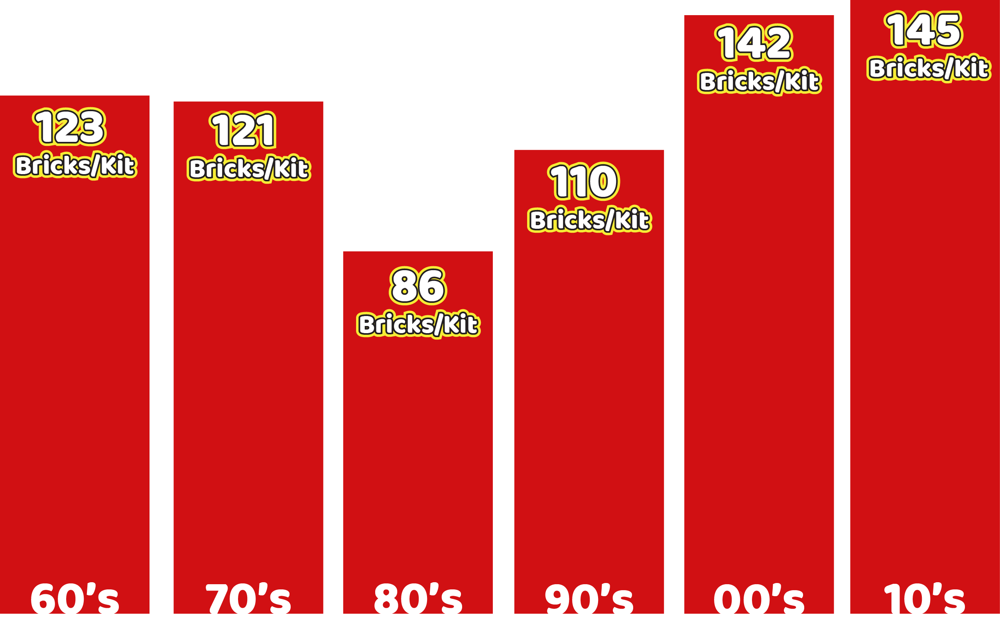

In [163]:
Image(filename='Lego4_2.png')

### 5.Sets with the most pieces

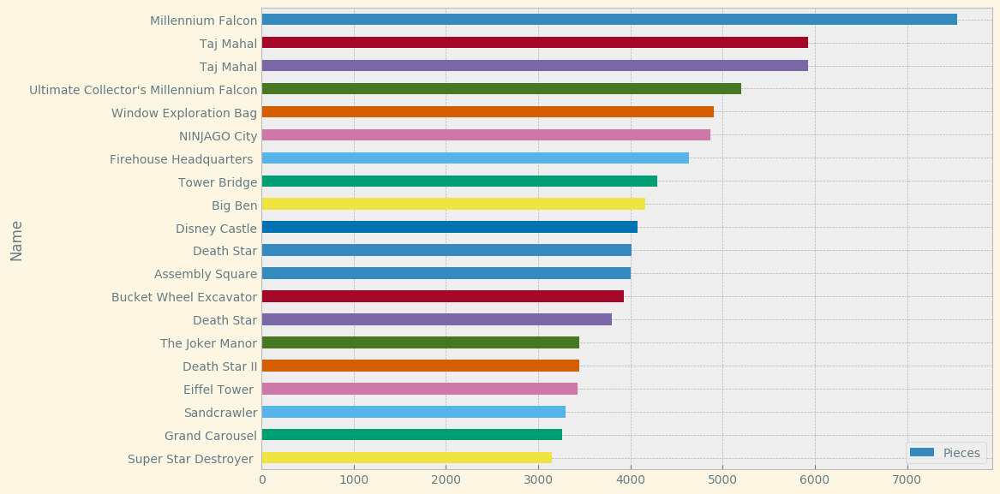

In [149]:
topsets=f_df_wth_inlftn[['Name','Year','Pieces','AdjPrice']]
topsets=topsets.sort_values (by='Pieces', ascending=False)
topsets.dropna().head(20).plot(x='Name',y='Pieces',kind='barh')
plt.gca().invert_yaxis()
plt.savefig("lego_most_pieces_set.pdf",bbox_inches='tight')



## 6.  Themes with most bricks

In [152]:
bricksthemes=f_df_wth_inlftn[['Theme','Pieces']]

In [153]:

bricksthemes.Pieces.dropna().astype(int,inplace=True)
df_final=bricksthemes.groupby('Theme').Pieces.sum().reset_index()
df_final=df_final.sort_values(by='Pieces',ascending=False)


In [154]:
df_final=df_final.head(20)

In [155]:
df_final.Pieces = df_final.Pieces.astype(int)

In [156]:
df_final.Pieces.dtype

dtype('int64')

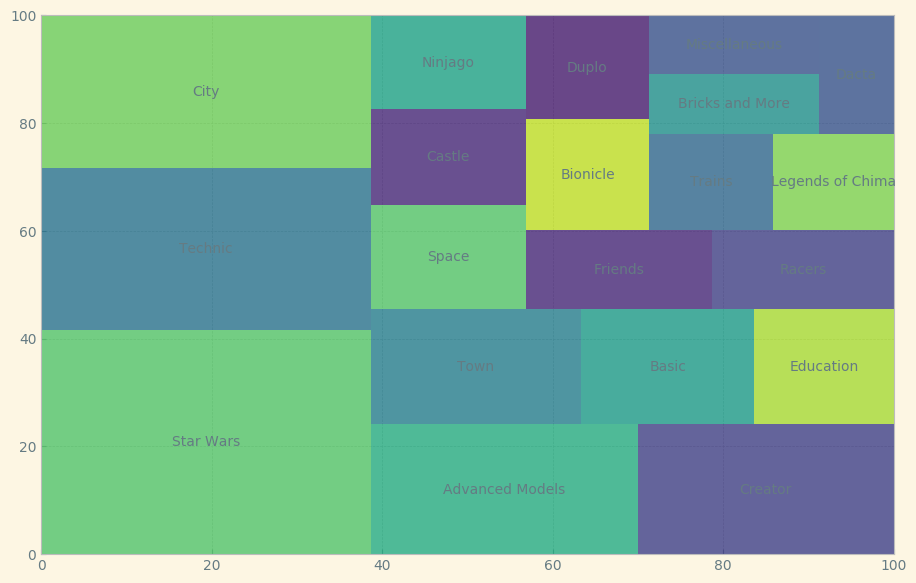

In [157]:
squarify.plot(sizes=[i for i in df_final['Pieces']], label=df_final['Theme'], alpha=.8)
plt.savefig("themes_pieces_set.pdf",bbox_inches='tight')



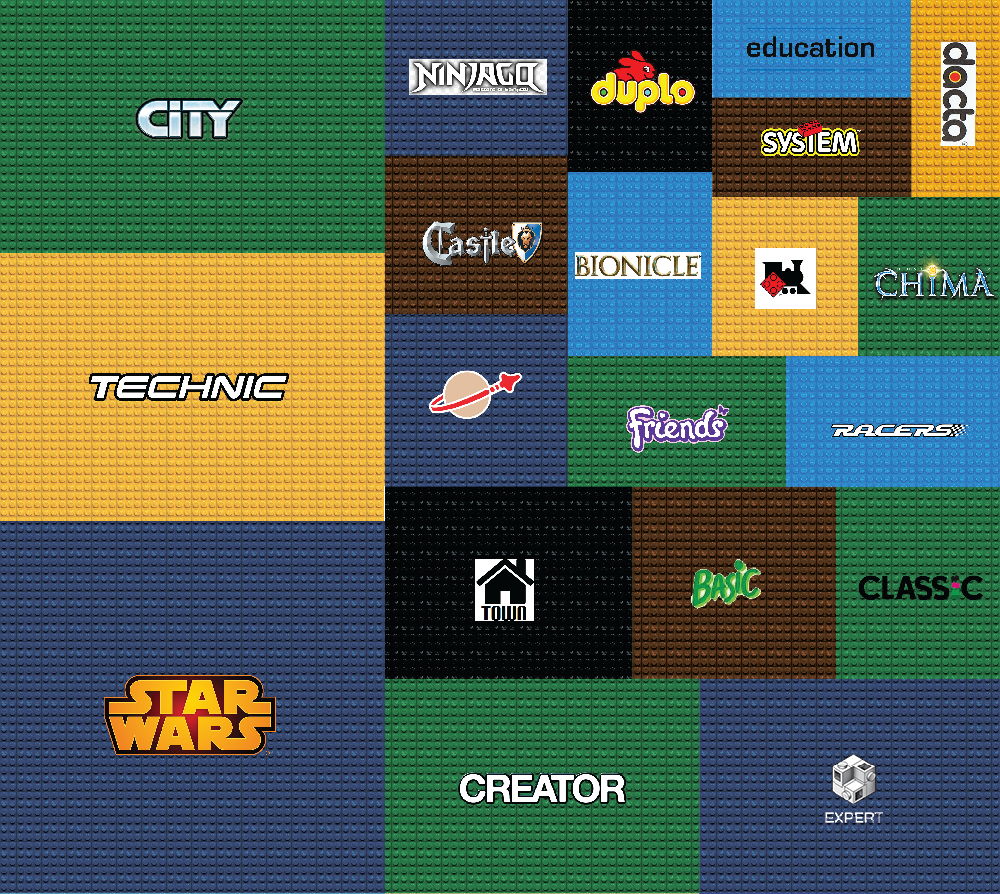

In [164]:
Image(filename='Lego5_1.png')

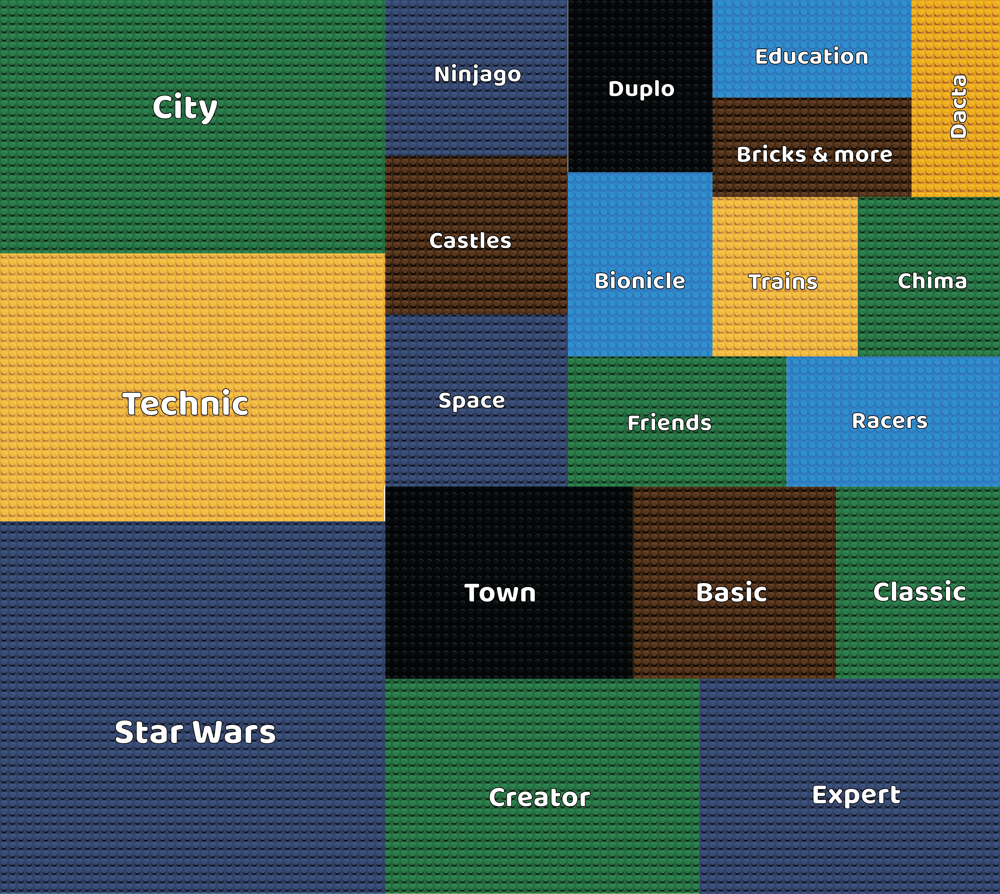

In [165]:
Image(filename='Legowthnames.png')